In [2]:
%matplotlib inline

In [3]:
import numpy as np
import pandas as pd

In [5]:
courses = (pd.read_csv("../input/h_2_courses.csv")
        .rename(columns={"наименование": "course_name", "max-score, максим который набрать": "max_possible_score", 
                         "проходной ли балл?": "is_passed", "сам ли назначил?": "does_he_appointed",
                         "когда активирован курс": "course_activated_at", "когда завершен": "course_finished_at",
                         "в срок ли завершен": "completed_in_period"
                        })
        .drop(['Unnamed: 10', 'Unnamed: 11', 'Unnamed: 12', 'Unnamed: 13', 'Unnamed: 14', 
               'Unnamed: 15', 'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18', 'Unnamed: 19', 'Unnamed: 20'], 1)
        .assign(course_activated_at = lambda x: pd.to_datetime(x["course_activated_at"], dayfirst=True))
        .assign(course_finished_at = lambda x: pd.to_datetime(x["course_finished_at"], dayfirst=True))
     )

In [6]:
import datetime
import locale

locale.setlocale(locale.LC_TIME, "ru_RU") 



#KPI ТП
df_kpi_tp = (pd.read_csv("../input/h_1_kpi_tp.csv", decimal=',')
             .rename(columns={"Должность": "position", 
                         "Балл": "score", 
                         "Месяц": "date"
                        })
             .assign(date = lambda x: x.date.apply(lambda el: datetime.datetime.strptime(el, "%b.%y")))
             
             .assign(score = lambda x: x["score"].str.replace(',', '.').str.replace(' ', ''))
             .assign(score = lambda x: x["score"].astype('float64'))
             .assign(score = lambda x: x.score.apply(lambda el: float('nan') if el > 100 or el == 0.0 else el))
     ).dropna(axis=0)



/Users/dpetrov/.anaconda/lib/python3.5/site-packages/matplotlib/axes/_base.py:2782: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735265.0, right=735265.0
  'left=%s, right=%s') % (left, right))
/Users/dpetrov/.anaconda/lib/python3.5/site-packages/matplotlib/axes/_base.py:2782: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735293.0, right=735293.0
  'left=%s, right=%s') % (left, right))
/Users/dpetrov/.anaconda/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/dpetrov/.anaconda/lib/python3.5/site-packages/matplotlib/axes/_base.py:

uid
u1           Axes(0.125,0.2;0.775x0.7)
u1003        Axes(0.125,0.2;0.775x0.7)
u1005        Axes(0.125,0.2;0.775x0.7)
u1006        Axes(0.125,0.2;0.775x0.7)
u101         Axes(0.125,0.2;0.775x0.7)
u1026        Axes(0.125,0.2;0.775x0.7)
u103         Axes(0.125,0.2;0.775x0.7)
u1031        Axes(0.125,0.2;0.775x0.7)
u1043        Axes(0.125,0.2;0.775x0.7)
u1044        Axes(0.125,0.2;0.775x0.7)
u1045        Axes(0.125,0.2;0.775x0.7)
u1047        Axes(0.125,0.2;0.775x0.7)
u1049        Axes(0.125,0.2;0.775x0.7)
u1056        Axes(0.125,0.2;0.775x0.7)
u106         Axes(0.125,0.2;0.775x0.7)
u1066        Axes(0.125,0.2;0.775x0.7)
u107         Axes(0.125,0.2;0.775x0.7)
u1077        Axes(0.125,0.2;0.775x0.7)
u108         Axes(0.125,0.2;0.775x0.7)
u1081        Axes(0.125,0.2;0.775x0.7)
u1084        Axes(0.125,0.2;0.775x0.7)
u1089        Axes(0.125,0.2;0.775x0.7)
u11          Axes(0.125,0.2;0.775x0.7)
u1102        Axes(0.125,0.2;0.775x0.7)
u1107        Axes(0.125,0.2;0.775x0.7)
u111         Axes(0.1

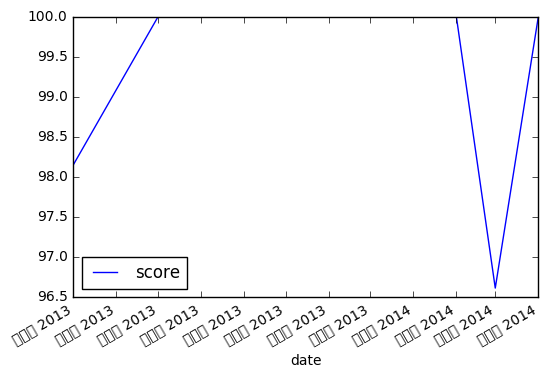

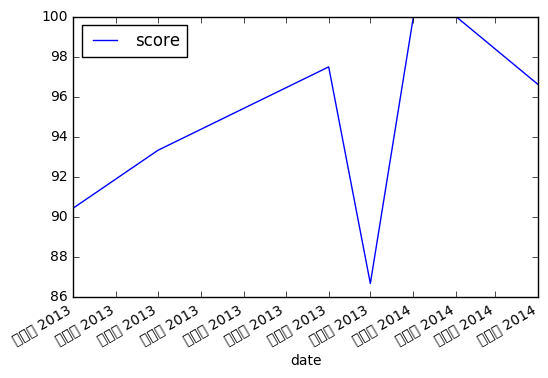

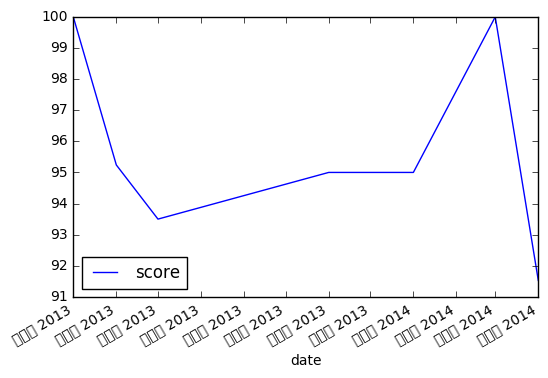

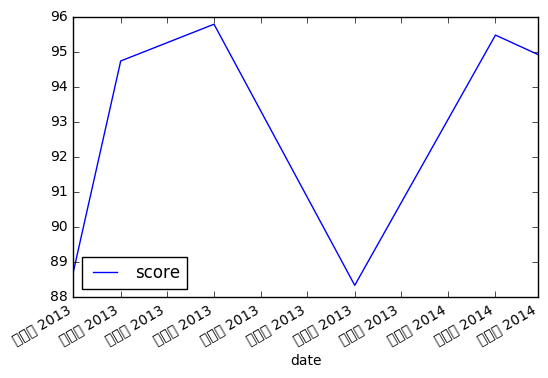

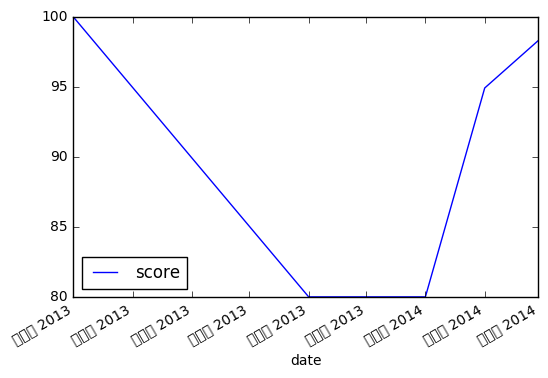

...

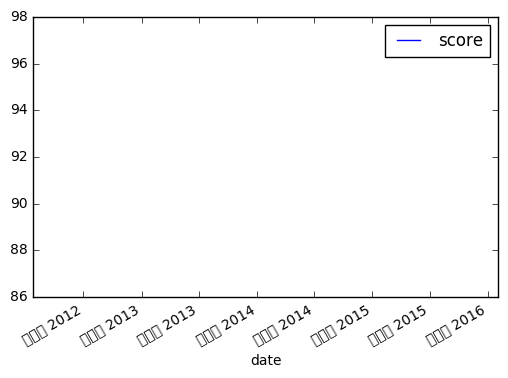

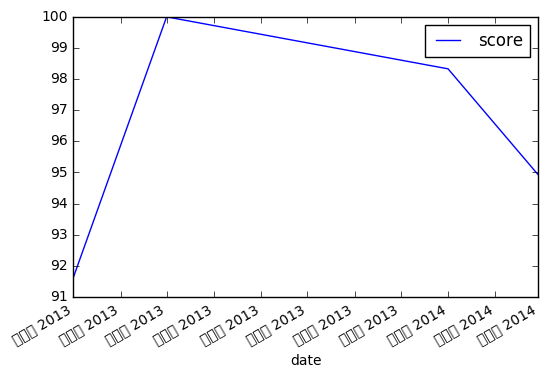

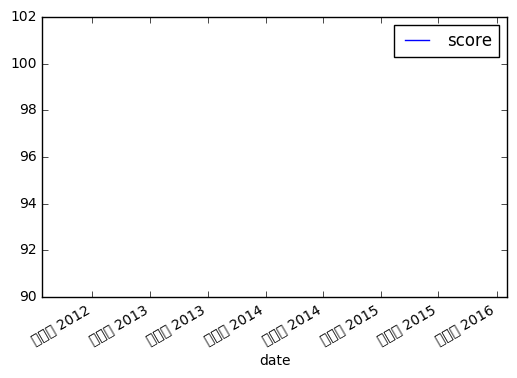

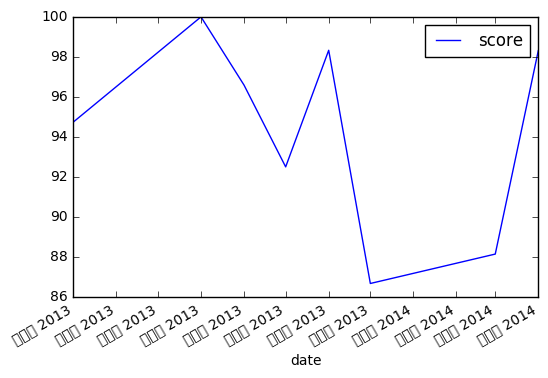

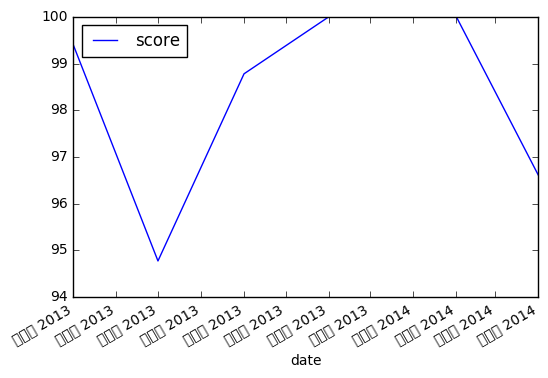

In [7]:
df_kpi_tp.groupby("uid")["score", "date"].plot(x="date", y="score")

In [8]:
#KPI ВПП 
df_kpi_vpp = (pd.read_csv("../input/h_1_kpi_vpp.csv", decimal=',')
              .rename(columns={"План сотрудника": "plan", 
                         "Факт сотрудника": "fact", 
                         "% вып-я": "percentage",
                         "Число_чеков":"sale_counts", 
                         "Ср.чек": "sale_average", 
                         "месяц": "date"
                        })
              .assign(percentage = lambda x: x["percentage"].str.replace(',', '.').str.replace(' ', ''))
              .assign(percentage = lambda x: x["percentage"].str.replace('#ДЕЛ/0!', 'NaN'))
              .assign(percentage = lambda x: x["percentage"].astype('float64'))
              .assign(percentage = lambda x: x["percentage"].apply(lambda el: el if el < 300 else float('nan')))
              .assign(sale_average = lambda x: x["sale_average"].str.replace(' ', '').str.replace(' ', ''))
#               .assign(sale_average = lambda x: x["sale_average"].astype('float64'), raise_on_error=False))
              .assign(date = lambda x: x.date.apply(lambda el: datetime.datetime.strptime(el, "%b.%y")))
              
     )


In [9]:
courses["course_finished_month"] = courses.course_finished_at.apply(lambda el: np.datetime64("{}-{:02d}".format(el.year, el.month)))

In [10]:
cumsum_courses_passed = courses.groupby(["uid", "course_finished_month"])["is_passed"].sum().reset_index()
cumsum_courses_passed["cumsum"] = cumsum_courses_passed.groupby("uid")["is_passed"].cumsum()

In [11]:
kpi_to_vpp = (df_kpi_vpp.groupby(["uid", "date"])["percentage"].max()
           .reset_index().merge(cumsum_courses_passed, left_on=["uid", "date"], right_on=["uid", "course_finished_month"]))

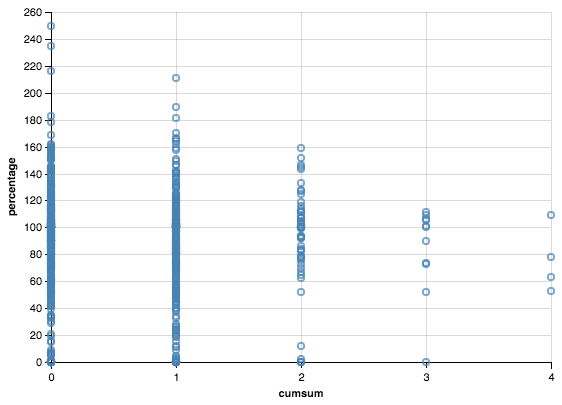

In [12]:
from altair import Chart

Chart(kpi_to_vpp).mark_point().encode(x='cumsum', y='percentage')

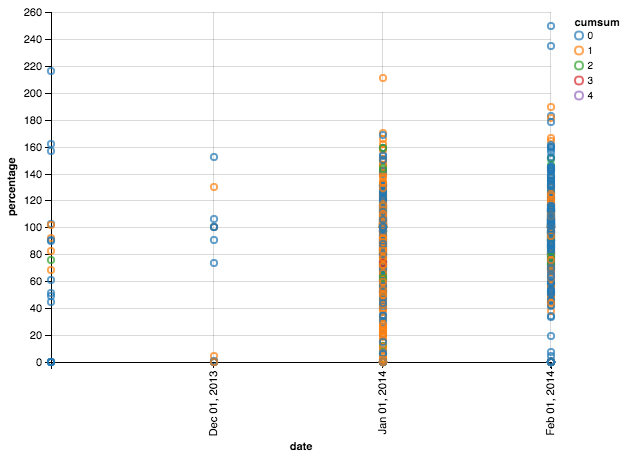

In [13]:
Chart(kpi_to_vpp).mark_point().encode(x='date', y='percentage', color='cumsum:N')

In [14]:
datetime.datetime.strptime("2013.06.30", "%Y.%m.%d")

datetime.datetime(2013, 6, 30, 0, 0)

In [15]:
df_offline = (pd.read_csv("../input/h_1_learning_offline.csv")
        .rename(columns={"наименование программы": "offline_program_name",
                         "Дата": "offline_date", 
                         "фактическое количество часов": "offline_time_spent",
                         "Оцека (если предусмотрена курсом)": "offline_time_plan",
                         "uid тренера": "offline_uid_coach"
                        })
        .assign(offline_date = lambda x: pd.to_datetime(x.offline_date, format="%Y.%m.%d", errors="coerce"))
        .drop(["is_webinar", "offline_time_spent", "offline_time_plan", "offline_uid_coach"], axis=1)
     ).dropna(axis=0)
      

In [16]:
df_offline = df_offline.assign(month_date = lambda x: x.offline_date.apply(lambda el: np.datetime64("{}-{:02d}".format(el.year, int(el.month)))))
df_offline["cnt"] = 1

In [17]:
df_offline_passed = df_offline.groupby(["uid", "month_date"]).cnt.sum().reset_index()
df_offline_passed["cumsum"] = df_offline_passed.groupby("uid")["cnt"].cumsum()

In [18]:
offcourses_to_vpp = (df_kpi_vpp.groupby(["uid", "date"])["percentage"].max()
           .reset_index().merge(df_offline_passed, left_on=["uid", "date"], right_on=["uid", "month_date"]))

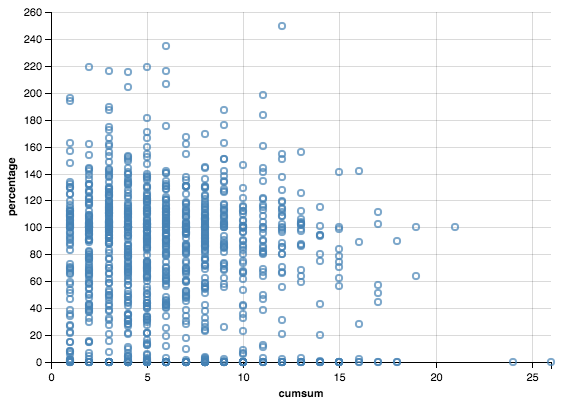

In [19]:
Chart(offcourses_to_vpp).mark_point().encode(x="cumsum", y="percentage")

In [20]:
anketa = (pd.read_csv("../input/h_1_anketa.csv")
            .rename(columns={"Пол": "sex", "ДатаРождения": "birthdate", "ДатаПриема": "date_p",
                             "УИН Подразделения": "unit_id", "ЭтоРуководитель": "is_top_manager",
                             "Место рождения": "birth_place", "Должность": "position"
                            })
            .assign(birthdate = lambda x: pd.to_datetime(x["birthdate"], dayfirst=True, errors="coerce"))
            .assign(priem = lambda x: pd.to_datetime(x["date_p"], dayfirst=True))
         )

In [21]:
anketa.head()

,uid,sex,birthdate,date_p,unit_id,is_top_manager,birth_place,position,priem
0,u1022,ж,1956-05-28,01.01.2009,fc8f3b92-e535-11e1-a52a-001b789beaf2,0,Москва,Менеджер по товародвижению,2009-01-01
1,u1023,ж,1956-05-28,01.01.2009,fc8f3b92-e535-11e1-a52a-001b789beaf2,0,Москва,Менеджер по товародвижению,2009-01-01
2,u1024,ж,1956-05-28,01.01.2009,fc8f3b92-e535-11e1-a52a-001b789beaf2,0,Москва,Менеджер по товародвижению,2009-01-01
3,u164,ж,1984-09-11,01.01.2014,NaN,0,Москва,Менеджер по развитию розничной сети,2014-01-01
4,u2117,м,1959-11-10,01.01.2014,dd63a709-6cfc-11e0-a872-001b789beaf2,0,Москва,Курьер,2014-01-01


In [30]:
expage_df = (df_kpi_vpp.merge(anketa, how="left", on="uid")
          .assign(exp=lambda x: (x["date"] - x["priem"])/ np.timedelta64(1, 'D'))
          .assign(age=lambda x: (x["date"] - x["birthdate"])/ np.timedelta64(1, 'D'))
)

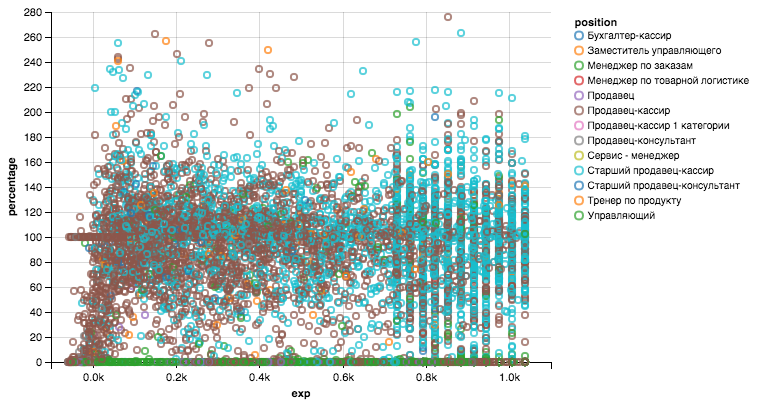

In [33]:
Chart(expage_df).mark_point().encode(x="exp", y="percentage", color="position:N")

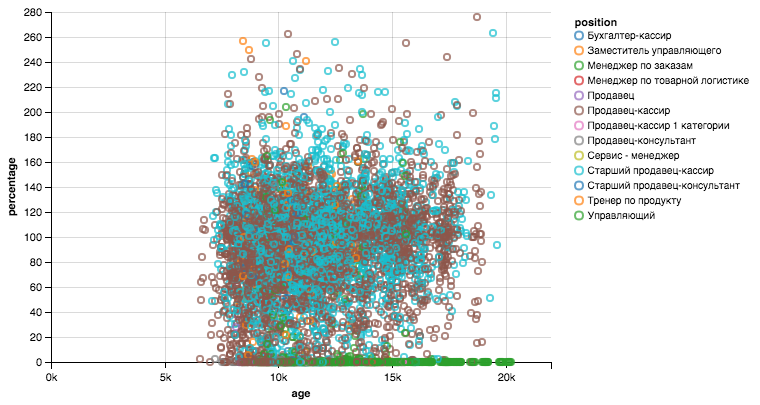

In [34]:
Chart(expage_df).mark_point().encode(x="age", y="percentage", color="position:N")